<a href="https://colab.research.google.com/github/Control-T/grafos_exerc/blob/main/trabalho5_grafos_bipartidos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Análise de dados em grafos - Atividade 5
#####Professor: Raimir Holanda
#####Aluno: Torricelli Evangelista
#####Curso: Mestrado em informática aplicada

##Fontes consultadas para o desenvolvimento dessa atividade:
###https://stackoverflow.com/questions/27084004/bipartite-graph-in-networkx/27085151

###https://towardsdatascience.com/matching-of-bipartite-graphs-using-networkx-6d355b164567

In [ ]:
import networkx as nx
from networkx.algorithms import bipartite
import matplotlib.pyplot as plt
import pandas as pd
%matplotlib inline

#1) Carregando o grafo a partir do arquivo CSV.

In [ ]:
path = '/content/ppgia_coautoria-bipartite.csv'
df = pd.read_csv(path, encoding='utf-8', sep=';')

In [ ]:
df['AUTORES'] = df['AUTORES'].replace(["Johnatas D'Orleans"],"Jonathan D'Orleans")
df['AUTORES'] = df['AUTORES'].replace(['Adriano Albuquerque','Adriano B Albuquerque','Adriano Bessa Albuquerque'],'Adriano Bessa Albuquerque')
df['AUTORES'] = df['AUTORES'].replace(['Aldísio G Medeiros'],'Aldisio Gonçalves Medeiros')
df['AUTORES'] = df['AUTORES'].replace(['Alexei Barbosa Aguiar'],'Alexei Barbosa De Aguiar')
df['AUTORES'] = df['AUTORES'].replace(['Placido Pinheiro','Placido R Pinheiro','Placido Rogerio Pinheiro','Placido Rogério Pinheiro','Plácido Pinheiro','Plácido R Pinheiro','Plácido Rogerio Pinheiro'],'Plácido Rogério Pinheiro')
df['AUTORES'] = df['AUTORES'].replace(['Elizabeth Furtado','Elizabeth S Furtado','Elizabeth Sucupira Furtado','Maria Elizabeth S Furtado','Maria Elizabeth Sucupira Furtado'],'Maria Elizabeth Sucupira Furtado')
df['AUTORES'] = df['AUTORES'].replace(['Pedro P R Filho','Pedro P Reboucas Filho','Pedro P Reboucras Filho','Pedro P Rebouças Filho','Pedro Pedrosa Reboucas Filho'],'Pedro Pedrosa Rebouças Filho')
df['AUTORES'] = df['AUTORES'].replace(['Raul V M Da Nóbrega','Raul Victor M Da Nobrega','Raul Victor M Da Nóbrega','Raul Victor Medeiros Da Nobrega'],'Raul Victor Medeiros Da Nóbrega')
df['AUTORES'] = df['AUTORES'].replace(['N C Mendonça','Nabor C Mendonça','Nabor Mendonça'],'Nabor Das Chagas Mendonça')
df['AUTORES'] = df['AUTORES'].replace(['Tarcisio H C Pequeno','Tarcisio Haroldo Cavalcante Pequeno','Tarcisio Pequeno','Tarcísio Cavalcante Pequeno','Tarcísio Pequeno','Tarcísio Pequeno Cavalcante'],'Tarcisio Haroldo Cavalcante Pequeno')
df['AUTORES'] = df['AUTORES'].replace(['Vladia Célia Pinheiro','Vladia Pinheiro','Vládia Célia Monteiro Pinheiro','Vládia Pinheiro'],'Vládia Célia Monteiro Pinheiro')
df['AUTORES'] = df['AUTORES'].replace(['Antonio C Da Silva Barros','Antonio C S Barros'],'Antonio Carlos Da Silva Barros')
df['AUTORES'] = df['AUTORES'].replace(['Bonfim A Junior','Bonfim Amaro Junior'],'Bonfim Amaro Júnior')
df['AUTORES'] = df['AUTORES'].replace(['Harilton Araújo','Harilton S Araujo'],'Harilton Da Silva Araujo')
df['AUTORES'] = df['AUTORES'].replace(['João Batista F Duarte','João Batista Furlan Duarte'],'João Batista Duarte Furlan')
df['AUTORES'] = df['AUTORES'].replace(['Mirian C D Pinheiro','Mirian Caliope Dantas Pinheiro'],'Mirian Calíope Dantas Pinheiro')
df['AUTORES'] = df['AUTORES'].replace(['Navar De M M Nascimento','Navar M M Nascimento'],'Navar M Mendonça E Nascimento')
df['AUTORES'] = df['AUTORES'].replace(['Rommel D Saraiva','Rommel Saraiva'],'Rommel Dias Saraiva')
df['AUTORES'] = df['AUTORES'].replace(['Suane P P Da Silva','Suane Pires P Da Silva'],'Suane Pires Pinheiro Da Silva')
df['AUTORES'] = df['AUTORES'].replace(['Victor Hugo C De Albuquerque'],'Victor Hugo Costa De Albuquerque')
df['AUTORES'] = df['AUTORES'].replace(['Valery Korotaev'],'Valery V Korotaev')
df['AUTORES'] = df['AUTORES'].replace(['Tiberius De Oliveira E Bonates'],'Tibérius De Oliveira E Bonates')
df['AUTORES'] = df['AUTORES'].replace(['Joao Jose Vasco Peixoto Furtado'],'Vasco Furtado')

In [ ]:
#df.head()

#Descobrindo a quantidade de títulos no dataframe sem repetições.

In [ ]:
titulos = df[['TITULO']].drop_duplicates()
pd.options.display.max_columns = None
pd.options.display.max_rows = None
print('Títulos: ', len(titulos), '\n\n', df.TITULO.value_counts() )

Títulos:  478 

 The Crosscutting Impact Of The Aosd Brazilian Research Community                                                                                                                    33
Cloud Computing And Reservoir Project                                                                                                                                               23
Using And Evaluating Augmented Reality For Mobile Data Visualization In Real Estate Classified Ads                                                                                  15
Reducing The Schizophrenia Stigma: A New Approach Based On Augmented Reality                                                                                                        14
Integration Of The Mobile Robot And Internet Of Things To Monitor Older People                                                                                                      14
Effective Features To Classify Big Data Using Social Internet Of Thi

In [ ]:
obras = list(titulos.iloc[:,0])
obras

['O Círculo Dos Nove Pontos',
 'Um Estudo Sobre As Perdas Em Barras De Ferro Através Da Programação Linear',
 'Técnicas Alternativas Para Resolução De Um Problema De Programação Linear',
 'De Um Problema De Programação Linear Geral Para A Forma Restrita De Karmarkar',
 'Uma Relaxação Do Método De Nível',
 'Problemas De Grande Porte: Uma Abordagem Aplicada A Programação Linear',
 'Conception Realisation Et Evaluation D Interfaces A Partir Des Specifications Conceptuelles',
 'Knowledge Acquisition Via Multi-Perspective Concept Formation',
 'Development Of A Computer System For Prediction Of Difficult Laryngoscopy',
 'An Updated 2D Model For Anatomical/Blade Interaction In Tracheal Intubation',
 'Modelling And Simulation Of The Tongue During Laryngoscopy',
 'Development Of A Physical Model Of The Laryngoscopy Procedure',
 'A Biomechanical Model Of The Upper Airways For Simulating Laryngoscopy',
 'Aplicações Gráficas Em Medicina: Técnicas E Modelos Realistas De Deformação',
 'Projeto Autom

In [ ]:
len(obras)

478

In [ ]:
emissor = list(autores.iloc[:,0])
emissor

['Plácido Rogério Pinheiro',
 'Humberto Jansen',
 'Adriana Carlos Paz',
 'Charles Bezerra Martins',
 'Neudson Cavalcante Albuquerque',
 'Rodrigo Moraes L De Araújo Costa',
 'Suzana Scheiberg',
 'Gudelia Baluarte Morales',
 'Marli Cardia',
 'Maria Elizabeth Sucupira Furtado',
 'Vasco Furtado',
 'Colette Faucher',
 'Eugene Chouraqui',
 'Maria Andréia Formico Rodrigues',
 'D F Gillies',
 'Peter Charters',
 'Richard Marks',
 'Peter Groom',
 'Duncan F Gillies',
 'Duncan Gillies',
 'Nabor Das Chagas Mendonça',
 'Jeff Kramer',
 'André Luís Vasconcelos Coelho',
 'Daniel Weingaertner',
 'Ricardo Gudwin',
 'Ivan Luiz Marques Ricarte',
 'Fernando Lincoln',
 'Raimir Holanda Filho',
 'Fernando Lincoln Mattos',
 'João José Vasco Peixoto Furtado',
 'Raimir Holanda',
 'Fernando Lincoln Matos',
 'João Batista Duarte Furlan',
 'J W Ribeiro',
 'Lobo P D C',
 'Jean Vanderdonckt',
 'João Manoel Pimenta',
 'Lutero Carmo De Lima',
 'Roberto Menescal Macedo',
 'Y F Lam',
 'Heraldo Da Silva Couto',
 'Clodoaldo

In [ ]:
len(emissor)

929

#Método para selecão das arestas.

In [ ]:
arestas = []

for t in range(0,478):
  novo = df[(df['TITULO']== obras[t])]
  
  for i in range(len(novo.iloc[:,1])):
    arestas.append((novo.iloc[i,1], novo.iloc[i,2]))
arestas

[('O Círculo Dos Nove Pontos', 'Plácido Rogério Pinheiro'),
 ('Um Estudo Sobre As Perdas Em Barras De Ferro Através Da Programação Linear',
  'Plácido Rogério Pinheiro'),
 ('Um Estudo Sobre As Perdas Em Barras De Ferro Através Da Programação Linear',
  'Humberto Jansen'),
 ('Técnicas Alternativas Para Resolução De Um Problema De Programação Linear',
  'Plácido Rogério Pinheiro'),
 ('Técnicas Alternativas Para Resolução De Um Problema De Programação Linear',
  'Adriana Carlos Paz'),
 ('Técnicas Alternativas Para Resolução De Um Problema De Programação Linear',
  'Charles Bezerra Martins'),
 ('Técnicas Alternativas Para Resolução De Um Problema De Programação Linear',
  'Neudson Cavalcante Albuquerque'),
 ('Técnicas Alternativas Para Resolução De Um Problema De Programação Linear',
  'Rodrigo Moraes L De Araújo Costa'),
 ('De Um Problema De Programação Linear Geral Para A Forma Restrita De Karmarkar',
  'Plácido Rogério Pinheiro'),
 ('De Um Problema De Programação Linear Geral Para A For

In [ ]:
len(arestas)

2370

#2) Representando os dados como um grafo bipartido entre os trabalhos publicados e os autores.

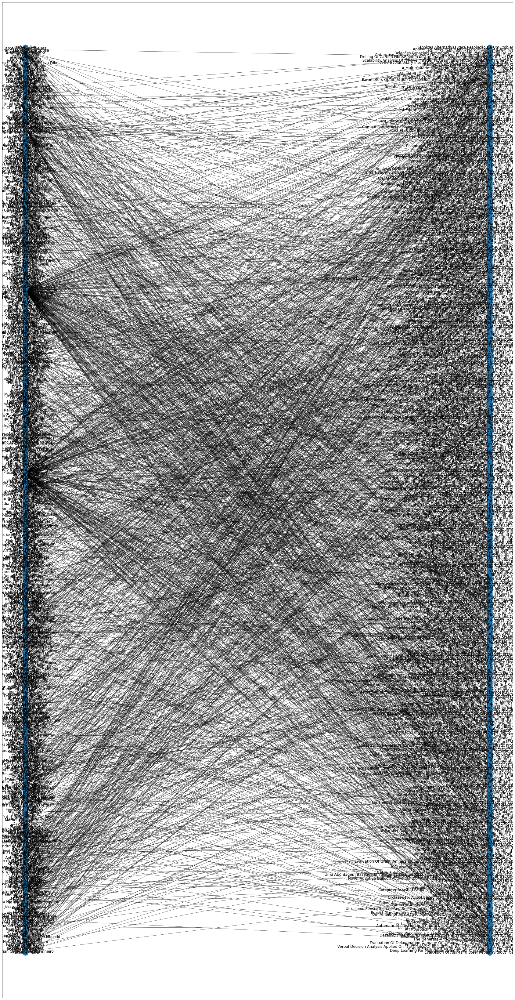

<Figure size 432x288 with 0 Axes>

In [ ]:
G = nx.Graph()

autor = emissor
artigo = obras

G.add_nodes_from(autor, bipartite=0)
G.add_nodes_from(artigo, bipartite=1)

G.add_edges_from(arestas)

plt.figure(figsize= (30,60))
nx.draw_networkx(G, pos = nx.drawing.layout.bipartite_layout(G, autor), width = 0.5) 
plt.show()
plt.clf()


In [ ]:
print(' Vértices_autores: ',len(autor), '\n', 'Vértices_artigos: ',len(obras), '\n', 'Quantidade de arestas: ', len(arestas))

 Vértices_autores:  929 
 Vértices_artigos:  478 
 Quantidade de arestas:  2370


#3) Gerando um grafo monopartido ponderado com apenas os autores.

In [ ]:
plt.figure(figsize= (130,130))
mono_bipartite_autor = bipartite.projected_graph(G, nx.bipartite.sets(G)[0])
nx.draw(mono_bipartite_autor, with_labels = True)
plt.show()
plt.clf()

<Figure size 432x288 with 0 Axes>

#4) Identificar os autores com maior colaboração com outros autores:

In [ ]:
compartilhamento_autor, compartilhamento_artigo = bipartite.degrees(G, autor)
autores_mais_colaborativos = dict(compartilhamento_artigo)

NameError: ignored

#5) Identificar os autores com maior quantidade de artigos compartilhados:

In [ ]:
autores = df[['AUTORES']].drop_duplicates()
pd.options.display.max_columns = None
pd.options.display.max_rows = None
print(' Autores: ', len(autores), '\n\n', df.AUTORES.value_counts() )


 Autores:  929 

 Victor Hugo Costa De Albuquerque          174
Plácido Rogério Pinheiro                  156
Maria Elizabeth Sucupira Furtado           52
Vasco Furtado                              46
Adriano Bessa Albuquerque                  42
Pedro Pedrosa Rebouças Filho               40
Maria Andréia Formico Rodrigues            38
Joel J P C Rodrigues                       37
André Luís Vasconcelos Coelho              31
J M R S Tavares                            30
João Batista Duarte Furlan                 28
Nabor Das Chagas Mendonça                  24
Raimir Holanda Filho                       24
Khan Muhammad                              19
Mirian Calíope Dantas Pinheiro             17
Vládia Célia Monteiro Pinheiro             17
Isabelle Tamanini                          14
Deepak Gupta                               13
Ashish Khanna                              12
Marum Simão Filho                          11
Napoleão Vieira Nepomuceno                 11
Thais Cristina S